In [2]:
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
from gensim.models import Word2Vec

from gensim.models import KeyedVectors
from sklearn.manifold import TSNE
from sklearn.metrics.pairwise import cosine_similarity
import numpy as np
import matplotlib.pyplot as plt


In [3]:
model = KeyedVectors.load_word2vec_format('50thousand.txt')

In [42]:
import pandas as pd
# 要计算的材料列表
materials = ['CsPbBr3', 'TiO2', 'ZnO', 'CsPbI3', 'MAPbI3', 'SrTiO3', 'BiFeO3', 'perovskite']

# 获取特征向量
vectors = []
for material in materials:
    vectors.append(model[material])

# 计算余弦相似性
cosine_sim_matrix = cosine_similarity(vectors)

# 转换为DataFrame
similarity_df = pd.DataFrame(cosine_sim_matrix, index=materials, columns=materials)

# 输出为CSV文件
similarity_df.to_csv('material_cosine_similarity.csv')

print(similarity_df)

             CsPbBr3      TiO2       ZnO    CsPbI3    MAPbI3    SrTiO3  \
CsPbBr3     1.000000  0.588770  0.570617  0.644184  0.732428  0.662724   
TiO2        0.588770  1.000000  0.731632  0.531824  0.581745  0.656890   
ZnO         0.570617  0.731632  1.000000  0.495131  0.599091  0.655760   
CsPbI3      0.644184  0.531824  0.495131  1.000000  0.750937  0.645867   
MAPbI3      0.732428  0.581745  0.599091  0.750937  1.000000  0.644126   
SrTiO3      0.662724  0.656890  0.655760  0.645867  0.644126  1.000000   
BiFeO3      0.621558  0.535821  0.523897  0.572425  0.550770  0.752402   
perovskite  0.611902  0.573109  0.485075  0.605441  0.731621  0.526565   

              BiFeO3  perovskite  
CsPbBr3     0.621558    0.611902  
TiO2        0.535821    0.573109  
ZnO         0.523897    0.485075  
CsPbI3      0.572425    0.605441  
MAPbI3      0.550770    0.731621  
SrTiO3      0.752402    0.526565  
BiFeO3      1.000000    0.485353  
perovskite  0.485353    1.000000  


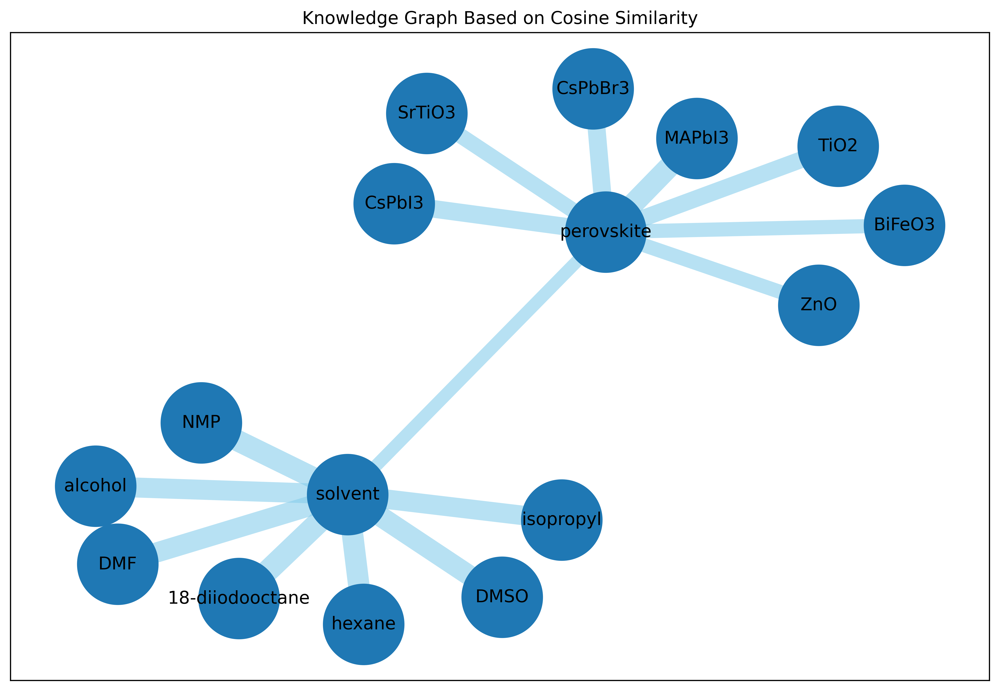

In [75]:
# 定义需要计算相似性的词汇
perovskites = ['CsPbBr3', 'TiO2', 'ZnO', 'CsPbI3', 'MAPbI3', 'SrTiO3', 'BiFeO3']
solvents = ['18-diiodooctane','NMP','hexane','DMSO','DMF','isopropyl','alcohol']
target_words = ['perovskite', 'solvent']

# 计算余弦相似性
similarities = {}

for word in perovskites:
    if word in model and 'perovskite' in model:
        similarities[(word, 'perovskite')] = model.similarity(word, 'perovskite')

for word in solvents:
    if word in model and 'solvent' in model:
        similarities[(word, 'solvent')] = model.similarity(word, 'solvent')

if 'perovskite' in model and 'solvent' in model:
    similarities[('perovskite', 'solvent')] = model.similarity('perovskite', 'solvent')

# 创建图
G = nx.Graph()

# 添加节点
for word in perovskites + solvents + target_words:
    G.add_node(word)

# 添加边并设置宽度
edges = []
for (word1, word2), sim in similarities.items():
    G.add_edge(word1, word2, weight=sim * 10)  # 乘以10使边的宽度更明显
    edges.append((word1, word2))

# 绘制图
plt.figure(figsize=(12, 8), dpi=500)
pos = nx.spring_layout(G, seed=42)  # 布局

# 绘制节点，设置节点颜色和大小

# 根据权重绘制边
weights = [G[u][v]['weight'] for u,v in edges]
# 绘制边，设置边颜色和透明度
# nx.draw_networkx_edges(G, pos, width=edge_widths, edge_color='gray', alpha=0.6)
nx.draw_networkx_edges(G, pos, edgelist=edges, width=[weight * 2 for weight in weights], edge_color='skyblue', alpha=0.6)  # 乘以2增加宽度

# 绘制节点和标签
nx.draw_networkx_nodes(G, pos, node_size=3000)
nx.draw_networkx_labels(G, pos, font_size=12)

plt.title('Knowledge Graph Based on Cosine Similarity')
plt.savefig('knowledge-graph.png')
plt.show()

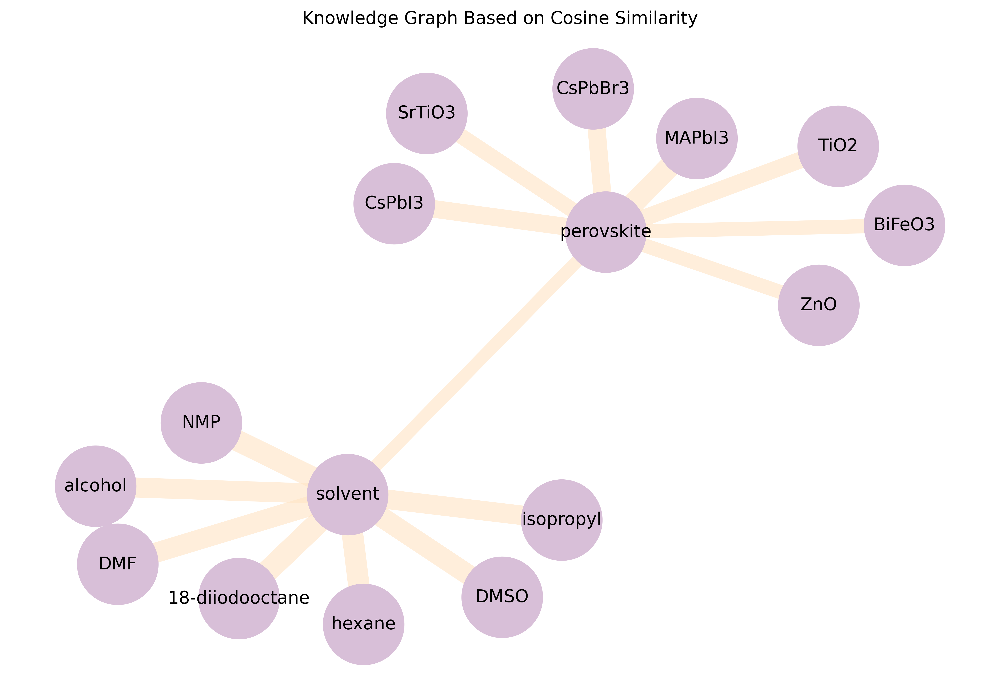

In [81]:

# 定义需要计算相似性的词汇
perovskites = ['CsPbBr3', 'TiO2', 'ZnO', 'CsPbI3', 'MAPbI3', 'SrTiO3', 'BiFeO3']
solvents = ['18-diiodooctane', 'NMP', 'hexane', 'DMSO', 'DMF', 'isopropyl', 'alcohol']
target_words = ['perovskite', 'solvent']

# 计算余弦相似性
similarities = {}

for word in perovskites:
    if word in model and 'perovskite' in model:
        similarities[(word, 'perovskite')] = model.similarity(word, 'perovskite')

for word in solvents:
    if word in model and 'solvent' in model:
        similarities[(word, 'solvent')] = model.similarity(word, 'solvent')

if 'perovskite' in model and 'solvent' in model:
    similarities[('perovskite', 'solvent')] = model.similarity('perovskite', 'solvent')

# 创建图
G = nx.Graph()

# 添加节点
for word in perovskites + solvents + target_words:
    G.add_node(word)

# 添加边并设置宽度
edges = []
for (word1, word2), sim in similarities.items():
    G.add_edge(word1, word2, weight=sim * 10)  # 乘以10使边的宽度更明显
    edges.append((word1, word2))

# 绘制图
plt.figure(figsize=(12, 8), dpi=500)
pos = nx.spring_layout(G, seed=42)  # 布局

# 根据权重绘制边
weights = [G[u][v]['weight'] for u, v in edges]

# 绘制边，设置边颜色和透明度
nx.draw_networkx_edges(G, pos, edgelist=edges, width=[weight * 2 for weight in weights], edge_color='bisque', alpha=0.6)  # 乘以2增加宽度

# 绘制节点和标签
nx.draw_networkx_nodes(G, pos, node_size=3000, node_color='thistle')  # 设置节点颜色为浅绿色
nx.draw_networkx_labels(G, pos, font_size=12)

plt.title('Knowledge Graph Based on Cosine Similarity')
plt.axis('off')  # 关闭坐标轴
plt.savefig('knowledge-graph.png')
plt.show()

In [109]:
# 定义需要计算相似性的词汇
perovskites = ['CsPbBr3', 'TiO2', 'ZnO', 'CsPbI3', 'MAPbI3', 'SrTiO3', 'BiFeO3']
solvents = ['18-diiodooctane', 'NMP', 'hexane', 'DMSO', 'DMF', 'isopropyl', 'alcohol']
HTL = ['P3HT', 'WOx', 'MoO3', 'Cu2O', 'PCDTBT', 'PEDOT', 'PMMA']
ETL=["TiO2", "NiOx", "Cs2CO3",'F16CuPc','MoOx','Sb2S3','CuI','PTCDA','PTB7','ZnO','CuInS2']
synthesis=['deposition','coating','annealing','casting']
structures=['layered','nanostructure','nanospheres','multi-shelled','flower-like','nanoplates','porous']
crystal =['P1','P2','P2','P3','P5']
cathode = ['Ag','Au','Al']
anode =['ITO','FTO','AZO']
property = ['hydrophilicity','electroactivity','wettability','biocompatibility','tunability']

target_words = ['property','perovskite', 'solvent', 'HTL','ETL','synthesis','structures','crystal','cathode','anode']

# 计算余弦相似性
similarities = {}

# 计算perovskites与perovskite的相似性
for word in perovskites:
    if word in model and 'perovskite' in model:
        similarities[(word, 'perovskite')] = model.similarity(word, 'perovskite')

# 计算solvents与solvent的相似性
for word in solvents:
    if word in model and 'solvent' in model:
        similarities[(word, 'solvent')] = model.similarity(word, 'solvent')

# 计算HTL与HTL的相似性
for word in HTL:
    if word in model and 'HTL' in model:
        similarities[(word, 'HTL')] = model.similarity(word, 'HTL')

# 计算HTL与HTL的相似性
for word in ETL:
    if word in model and 'ETL' in model:
        similarities[(word, 'ETL')] = model.similarity(word, 'ETL')
# 计算HTL与HTL的相似性
for word in synthesis:
    if word in model and 'synthesis' in model:
        similarities[(word, 'synthesis')] = model.similarity(word, 'synthesis')
for word in structures:
    if word in model and 'structures' in model:
        similarities[(word, 'structures')] = model.similarity(word, 'structures')
for word in crystal:
    if word in model and 'crystal' in model:
        similarities[(word, 'crystal')] = model.similarity(word, 'crystal')
for word in cathode:
    if word in model and 'cathode' in model:
        similarities[(word, 'cathode')] = model.similarity(word, 'cathode')
for word in cathode:
    if word in model and 'anode' in model:
        similarities[(word, 'anode')] = model.similarity(word, 'anode')        
for word in property:
    if word in model and 'property' in model:
        similarities[(word, 'property')] = model.similarity(word, 'property')
                                                            
# 计算target_words之间的相似性
for i in range(len(target_words)):
    for j in range(i + 1, len(target_words)):
        word1 = target_words[i]
        word2 = target_words[j]
        if word1 in model and word2 in model:
            similarities[(word1, word2)] = model.similarity(word1, word2)

# 创建图
G = nx.Graph()

# 添加节点
for word in perovskites + solvents + HTL + target_words:
    G.add_node(word)

# 添加边并设置宽度
edges = []
for (word1, word2), sim in similarities.items():
    G.add_edge(word1, word2, weight=sim * 10)  # 乘以10使边的宽度更明显
    edges.append((word1, word2))

# 绘制图
# plt.figure(figsize=(12, 8), dpi=800)
plt.figure(figsize=(18,18), dpi=1000)
pos = nx.spring_layout(G, seed=42,k=1.0)  # 布局

# 根据权重绘制边
weights = [G[u][v]['weight'] for u, v in edges]

# 绘制边，设置边颜色和透明度
nx.draw_networkx_edges(G, pos, edgelist=edges, width=[weight * 2 for weight in weights], edge_color='bisque', alpha=0.6)  # 乘以2增加宽度

# 绘制节点和标签
nx.draw_networkx_nodes(G, pos, node_size=3000, node_color='thistle')  # 设置节点颜色为浅绿色
nx.draw_networkx_labels(G, pos, font_size=12)

plt.title('Knowledge Graph Based on Cosine Similarity')
plt.axis('off')  # 关闭坐标轴
plt.savefig('knowledge-graph.png')
plt.show()

In [111]:
# 定义需要计算相似性的词汇
perovskites = ['CsPbBr3', 'TiO2', 'ZnO', 'CsPbI3', 'MAPbI3', 'SrTiO3', 'BiFeO3']
solvents = ['18-diiodooctane', 'NMP', 'hexane', 'DMSO', 'DMF', 'isopropyl', 'alcohol']
HTL = ['P3HT', 'WOx', 'MoO3', 'Cu2O', 'PCDTBT', 'PEDOT', 'PMMA']
ETL=["TiO2", "NiOx", "Cs2CO3",'F16CuPc','MoOx','Sb2S3','CuI','PTCDA','PTB7','ZnO','CuInS2']
synthesis=['deposition','coating','annealing','casting']
structures=['layered','nanostructure','nanospheres','multi-shelled','flower-like','nanoplates','porous']
crystal =['P1','P2','P2','P3','P5']
cathode = ['Ag','Au','Al']
anode =['ITO','FTO','AZO']
property = ['hydrophilicity','electroactivity','wettability','biocompatibility','tunability']

target_words = ['property','perovskite', 'solvent', 'HTL','ETL','synthesis','structures','crystal','cathode','anode']

# 计算余弦相似性
similarities = {}

# 计算perovskites与perovskite的相似性
for word in perovskites:
    if word in model and 'perovskite' in model:
        similarities[(word, 'perovskite')] = model.similarity(word, 'perovskite')

# 计算solvents与solvent的相似性
for word in solvents:
    if word in model and 'solvent' in model:
        similarities[(word, 'solvent')] = model.similarity(word, 'solvent')

# 计算HTL与HTL的相似性
for word in HTL:
    if word in model and 'HTL' in model:
        similarities[(word, 'HTL')] = model.similarity(word, 'HTL')

# 计算HTL与HTL的相似性
for word in ETL:
    if word in model and 'ETL' in model:
        similarities[(word, 'ETL')] = model.similarity(word, 'ETL')
# 计算HTL与HTL的相似性
for word in synthesis:
    if word in model and 'synthesis' in model:
        similarities[(word, 'synthesis')] = model.similarity(word, 'synthesis')
for word in structures:
    if word in model and 'structures' in model:
        similarities[(word, 'structures')] = model.similarity(word, 'structures')
for word in crystal:
    if word in model and 'crystal' in model:
        similarities[(word, 'crystal')] = model.similarity(word, 'crystal')
for word in cathode:
    if word in model and 'cathode' in model:
        similarities[(word, 'cathode')] = model.similarity(word, 'cathode')
for word in cathode:
    if word in model and 'anode' in model:
        similarities[(word, 'anode')] = model.similarity(word, 'anode')        
for word in property:
    if word in model and 'property' in model:
        similarities[(word, 'property')] = model.similarity(word, 'property')
                                                            
# 计算target_words之间的相似性
for i in range(len(target_words)):
    for j in range(i + 1, len(target_words)):
        word1 = target_words[i]
        word2 = target_words[j]
        if word1 in model and word2 in model:
            similarities[(word1, word2)] = model.similarity(word1, word2)

# 创建图
G = nx.Graph()

# 添加节点
for word in perovskites + solvents + HTL + target_words:
    G.add_node(word)

# 添加边并设置宽度
edges = []
for (word1, word2), sim in similarities.items():
    G.add_edge(word1, word2, weight=sim * 10)  # 乘以10使边的宽度更明显
    edges.append((word1, word2))

# 绘制图
# plt.figure(figsize=(12, 8), dpi=800)
plt.figure(figsize=(18,18), dpi=1000)
pos = nx.spring_layout(G, seed=42)  # 布局

# 根据权重绘制边
weights = [G[u][v]['weight'] for u, v in edges]

# 绘制边，设置边颜色和透明度
nx.draw_networkx_edges(G, pos, edgelist=edges, width=[weight * 2 for weight in weights], edge_color='bisque', alpha=0.6)  # 乘以2增加宽度

# 绘制节点和标签
nx.draw_networkx_nodes(G, pos, node_size=3000, node_color='thistle')  # 设置节点颜色为浅绿色
nx.draw_networkx_labels(G, pos, font_size=12)

plt.title('Knowledge Graph Based on Cosine Similarity')
plt.axis('off')  # 关闭坐标轴
plt.savefig('knowledge-graph12.png')
plt.show()

In [114]:
# 导入所需的库
import matplotlib.pyplot as plt
import networkx as nx
from sklearn.metrics.pairwise import cosine_similarity

# 定义需要计算相似性的词汇
perovskites = ['CsPbBr3', 'TiO2', 'ZnO', 'CsPbI3', 'MAPbI3', 'SrTiO3', 'BiFeO3']
solvents = ['18-diiodooctane', 'NMP', 'hexane', 'DMSO', 'DMF', 'isopropyl', 'alcohol']
HTL = ['P3HT', 'WOx', 'MoO3', 'Cu2O', 'PCDTBT', 'PEDOT', 'PMMA']
ETL = ['TiO2', 'NiOx', 'Cs2CO3', 'F16CuPc', 'MoOx', 'Sb2S3', 'CuI', 'PTCDA', 'PTB7', 'ZnO', 'CuInS2']
synthesis = ['deposition', 'coating', 'annealing', 'casting']
structures = ['layered', 'nanostructure', 'nanospheres', 'multi-shelled', 'flower-like', 'nanoplates', 'porous']
crystal = ['P1', 'P2', 'P3', 'P5']
cathode = ['Ag', 'Au', 'Al']
anode = ['ITO', 'FTO', 'AZO']
property = ['hydrophilicity', 'electroactivity', 'wettability', 'biocompatibility', 'tunability']

target_words = ['property', 'perovskite', 'solvent', 'HTL', 'ETL', 'synthesis', 'structures', 'crystal', 'cathode', 'anode']

# 计算余弦相似性
similarities = {}

# 计算各类别词汇与目标词汇的相似性
categories = {'perovskite': perovskites, 'solvent': solvents, 'HTL': HTL, 'ETL': ETL, 
              'synthesis': synthesis, 'structures': structures, 'crystal': crystal, 
              'cathode': cathode, 'anode': anode, 'property': property}

for target_word, category in categories.items():
    if target_word in target_words:
        for word in category:
            if word in model and target_word in model:
                similarities[(word, target_word)] = model.similarity(word, target_word)

# 计算target_words之间的相似性
for i in range(len(target_words)):
    for j in range(i + 1, len(target_words)):
        word1 = target_words[i]
        word2 = target_words[j]
        if word1 in model and word2 in model:
            similarities[(word1, word2)] = model.similarity(word1, word2)

# 创建图
G = nx.Graph()

# 添加节点
all_words = perovskites + solvents + HTL + ETL + synthesis + structures + crystal + cathode + anode + property + target_words
for word in all_words:
    G.add_node(word)

# 添加边并设置宽度
edges = []
for (word1, word2), sim in similarities.items():
    G.add_edge(word1, word2, weight=sim * 10)  # 乘以10使边的宽度更明显
    edges.append((word1, word2))

# 绘制图
plt.figure(figsize=(18, 18), dpi=1000)
pos = nx.spring_layout(G, seed=42, k=0.5)  # 增加k值以增大节点间距

# 根据权重绘制边
weights = [G[u][v]['weight'] for u, v in edges]

# 绘制边，设置边颜色和透明度
nx.draw_networkx_edges(G, pos, edgelist=edges, width=[weight * 2 for weight in weights], edge_color='bisque', alpha=0.6)  # 乘以2增加宽度

# 绘制节点和标签
nx.draw_networkx_nodes(G, pos, node_size=3000, node_color='thistle')  # 设置节点颜色为浅绿色
nx.draw_networkx_labels(G, pos, font_size=12)

plt.title('Knowledge Graph Based on Cosine Similarity')
plt.axis('off')  # 关闭坐标轴

# 保存为JPEG格式
plt.savefig('knowledge-graph12.png')
plt.show()






findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.


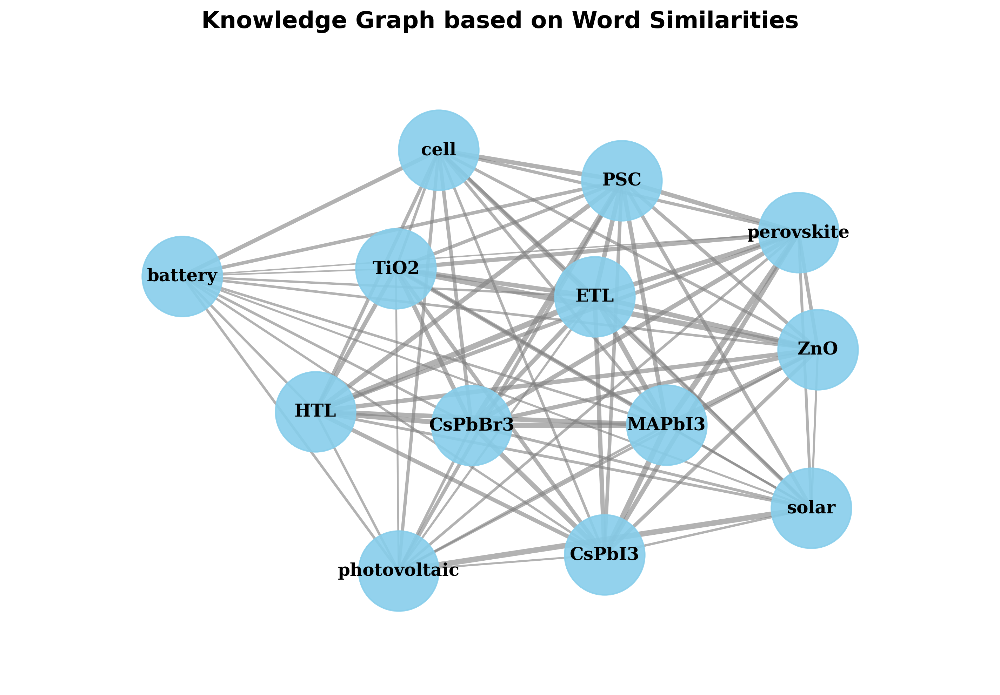

In [24]:
# 定义要计算相似性的词语列表
words = ['perovskite', 'ETL', 'HTL', 'TiO2','ZnO','battery','solar','photovoltaic','cell','MAPbI3','CsPbI3','CsPbBr3','PSC']

# 创建一个图
G = nx.Graph()

# 添加节点
for word in words:
    G.add_node(word)

# 计算每对词语之间的余弦相似性，并添加边
for i in range(len(words)):
    for j in range(i + 1, len(words)):
        word1 = words[i]
        word2 = words[j]
        if word1 in model and word2 in model:
            similarity = model.similarity(word1, word2)
            G.add_edge(word1, word2, weight=similarity)

# 设置绘图参数
plt.figure(figsize=(12, 8), dpi=300)
pos = nx.spring_layout(G, seed=42)  # 布局

# 绘制节点，设置节点颜色和大小
nodes = nx.draw_networkx_nodes(G, pos, node_size=3000, node_color='skyblue', alpha=0.9)

# 绘制标签，设置字体
labels = nx.draw_networkx_labels(G, pos, font_size=12, font_family='serif', font_weight='bold', font_color='black')

# 根据相似性值设置边的宽度
edges = G.edges(data=True)
edge_widths = [d['weight'] * 5 for (u, v, d) in edges]  # 乘以5使线条更明显

# 绘制边，设置边颜色和透明度
nx.draw_networkx_edges(G, pos, width=edge_widths, edge_color='gray', alpha=0.6)

# # 优化显示
# for _, t in labels.items():
#     t.set_fontfamily('Times New Roman')

# 调整边界
plt.margins(x=0.2, y=0.2)
plt.title('Knowledge Graph based on Word Similarities', fontsize=16, fontweight='bold', fontname='Times New Roman')
plt.axis('off')  # 关闭坐标轴
plt.savefig('knowledge-graph.png')  # 可以将文件名修改为您想要的文件名和路径
plt.show()



findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.


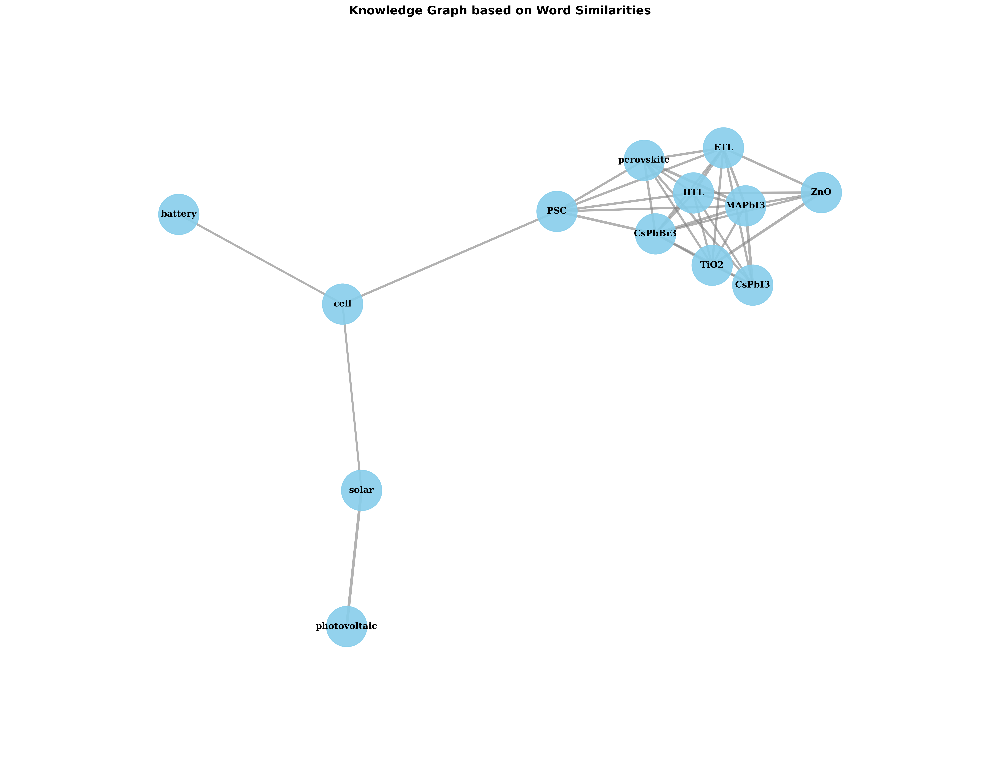

In [34]:
# 定义要计算相似性的词语列表
words = ['perovskite', 'ETL', 'HTL', 'TiO2','ZnO','battery','solar','photovoltaic','cell','MAPbI3','CsPbI3','CsPbBr3','PSC']

# 创建一个图
G = nx.Graph()

# 添加节点
for word in words:
    G.add_node(word)

# 计算每对词语之间的余弦相似性，并添加边
for i in range(len(words)):
    for j in range(i + 1, len(words)):
        word1 = words[i]
        word2 = words[j]
        if word1 in model and word2 in model:
            similarity = model.similarity(word1, word2)
            if similarity >= 0.5:  # 只添加相似性大于等于0.1的边
                G.add_edge(word1, word2, weight=similarity)

# 设置绘图参数
plt.figure(figsize=(24, 18), dpi=300)  # 增大图像尺寸
pos = nx.spring_layout(G, seed=42, k=0.5)  # 布局

# 绘制节点，设置节点颜色和大小
nodes = nx.draw_networkx_nodes(G, pos, node_size=3000, node_color='skyblue', alpha=0.9)

# 绘制标签，设置字体
labels = nx.draw_networkx_labels(G, pos, font_size=12, font_family='serif', font_weight='bold', font_color='black')

# 根据相似性值设置边的宽度
edges = G.edges(data=True)
edge_widths = [d['weight'] * 5 for (u, v, d) in edges]  # 乘以5使线条更明显

# 绘制边，设置边颜色和透明度
nx.draw_networkx_edges(G, pos, width=edge_widths, edge_color='gray', alpha=0.6)

# # 优化显示
# for _, t in labels.items():
#     t.set_fontfamily('Times New Roman')

# 调整边界
plt.margins(x=0.2, y=0.2)
plt.title('Knowledge Graph based on Word Similarities', fontsize=16, fontweight='bold', fontname='Times New Roman')
plt.axis('off')  # 关闭坐标轴
plt.savefig('knowledge-graph.png')  # 保存图像
plt.show()

findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times Ne

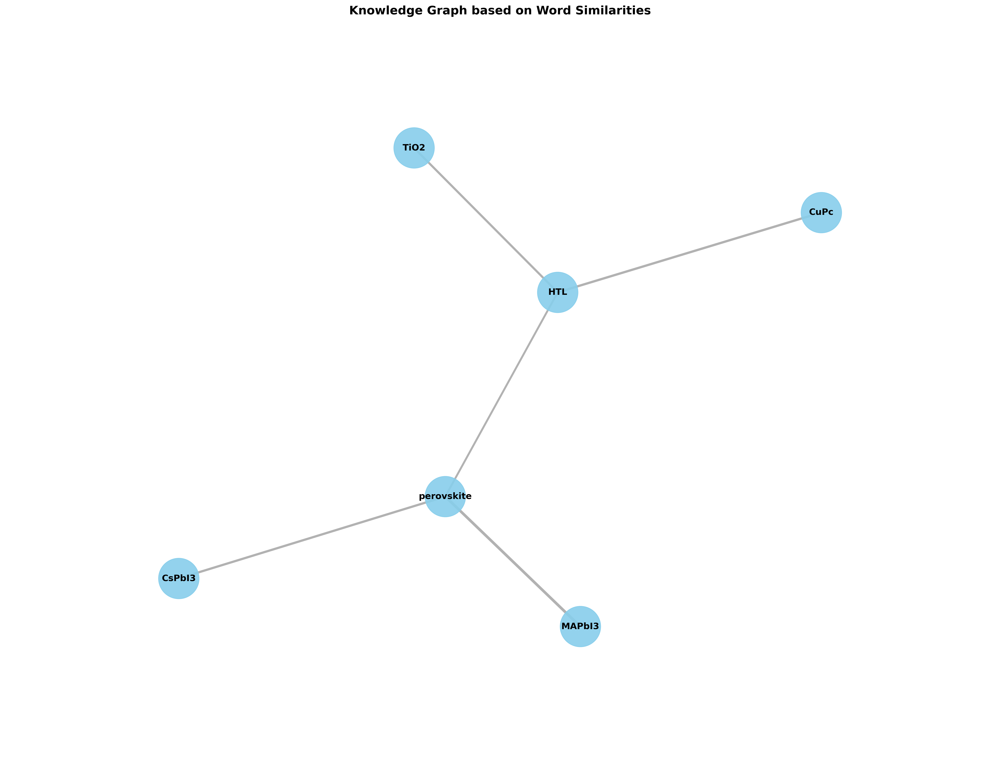

In [30]:
# 定义核心词汇
core_words = ['HTL', 'perovskite']

# 定义相关词汇
perovskite_related_words = ['MAPbI3', 'CsPbI3', 'perovskite']
HTL_related_words = ['CuPc', 'TiO2', 'HTL']

# 创建一个图
G = nx.Graph()

# 添加核心节点
for word in core_words:
    G.add_node(word)

# 添加相关节点
for word in perovskite_related_words:
    if word != 'perovskite':
        G.add_node(word)
for word in HTL_related_words:
    if word != 'HTL':
        G.add_node(word)

# 计算核心词汇之间的余弦相似性，并添加边
for i in range(len(core_words)):
    for j in range(i + 1, len(core_words)):
        word1 = core_words[i]
        word2 = core_words[j]
        if word1 in model and word2 in model :
            similarity = model.similarity(word1, word2)
            G.add_edge(word1, word2, weight=similarity)

# 计算相关词汇与核心词汇之间的余弦相似性，并添加边
for word in perovskite_related_words:
    if word in model and 'perovskite' in model and word != 'perovskite':
        similarity = model.similarity(word, 'perovskite')
        G.add_edge(word, 'perovskite', weight=similarity)

for word in HTL_related_words:
    if word in model and 'HTL' in model and word != 'HTL':
        similarity = model.similarity(word, 'HTL')
        G.add_edge(word, 'HTL', weight=similarity)

# 设置绘图参数
plt.figure(figsize=(24, 18), dpi=300)  # 增大图像尺寸
pos = nx.spring_layout(G, seed=42, k=0.5)  # 调整k值使节点间距更大

# 绘制节点，设置节点颜色和大小
nodes = nx.draw_networkx_nodes(G, pos, node_size=3000, node_color='skyblue', alpha=0.9)

# 绘制标签，设置字体
labels = nx.draw_networkx_labels(G, pos, font_size=12, font_family='serif', font_weight='bold', font_color='black')

# 根据相似性值设置边的宽度
edges = G.edges(data=True)
edge_widths = [d['weight'] * 5 for (u, v, d) in edges]  # 乘以5使线条更明显

# 绘制边，设置边颜色和透明度
nx.draw_networkx_edges(G, pos, width=edge_widths, edge_color='gray', alpha=0.6)

# 优化显示
for _, t in labels.items():
    t.set_fontfamily('Times New Roman')

# 调整边界
plt.margins(x=0.2, y=0.2)
plt.title('Knowledge Graph based on Word Similarities', fontsize=16, fontweight='bold', fontname='Times New Roman')
plt.axis('off')  # 关闭坐标轴
plt.show()